In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from numpy.fft import irfft
from numpy import sin, cos, pi , exp
import itertools
import operator
import json
import math 
from math import pi
from scipy.interpolate import interp1d
from scipy.signal.windows import blackman # window function
from scipy.signal.windows import barthann
from scipy.signal.windows import chebwin
from scipy.fftpack import fft, fftfreq, ifft
from scipy.optimize import curve_fit
from collections.abc import Iterable

import plotly
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
from plotly.offline import iplot, init_notebook_mode
from pathlib import Path



plotly.io.orca.config.executable = '/Applications/orca.app/Contents/MacOS/orca'
plotly.io.orca.config.save()
figborderlinesize = 0.7
legborderlinesize = 0.7
pd.options.display.max_columns = None

theta_sym ='\u03B8'
delta_sym = '\u03B4'
Delta_sym = '\u0394'
Sigma_sym = '\u03A3'
omega_sym = '\u03C9'
hat_sym   = '\u0302' #symbol + hat_sym

### STYLE
yaxis = dict(
              tickfont = dict(
              family = 'Times New Roman',
              size = 20,
              color = 'black'
              ),
              titlefont = dict(
                  family = 'Times New Roman',
                  size = 25,
                  color = 'black'
              ),
          )
xaxis = dict(
              tickfont = dict(
                  family = 'Times New Roman',
                  size = 20,
                  color = 'black'
              ),
              titlefont = dict(
                  family = 'Times New Roman',
                  size = 25,
                  color = 'black'
              )
          )
axis_style = dict(showline=True, gridwidth=1, gridcolor='lightgrey', linewidth=1, linecolor='black', mirror=True, ticks='outside',
                 tickfont = dict(family = 'Times New Roman', size = 18, color = 'black'))
bg_style = {'plot_bgcolor': 'rgba(255, 255, 255, 1)', 'paper_bgcolor': 'rgba(255, 255, 255, 1)',}
colors =   {'experiment':'blue', 'Fluent':'red', 'OpenFOAM':'hsv(120,100,100)', 'BPM':'black', 'MagniniModel':'orange' }

mode_lines_all=['lines']*20
mode_lines_and_markers_all=['lines+markers']*20

In [2]:
def plot_graph(list_x_, list_y_, names, xtitle, ytitle, image_name, list_errors=None, add_error_bar=None, mode=['lines+markers']*20,
               xrange=[], yrange=[],
               dash=['solid', 'dot', 'dash', 'longdash'],
               colors=['blue', 'red', 'hsv(120,100,100)', 'green', 'black' ],
               marker_size=15, line_size=3,
               marker_style = ['circle' ]*20, #'triangle-up', 'triangle-down','square', 'diamond', 'cross',  'x-thin', 'cross-thin' 
               width=1000, height=500, path='./', xlog=False, ylog=False, 
               yanchor='top', y0_anchor=0.99, xanchor='right', x0_anchor=0.99, legend_orientation=None, showlegend=True,
               legborderlinesize=0.7, figborderlinesize=0.7, lmargin=0, rmargin=0, bmargin=0, tmargin=0, padmargin=0.1, debug=False,
               legendfont_size=18, tickfont_size=18, titlefont_size=20):

    list_x, list_y = [], []
    for i,x in enumerate(list_x_):
        y = list_y_[i]
        list_x.append(np.array(x))
        list_y.append(np.array(y))
    if mode == []:
        for i in range(len(list_x)):
            mode.append('lines+markers')
    if xrange == []:
        minx, maxx = [], []
        for i,x in enumerate(list_x):
            minx.append(x.min())
            maxx.append(x.max())
        xrange = [minx, maxx]
    if yrange == []:
        miny, maxy = [], []
        for i,y in enumerate(list_y):
            miny.append(y.min())
            maxy.append(y.max())
        yrange = [miny, maxy]

    axis_style = dict(showline=True, 
                  gridwidth=1, 
                  gridcolor='lightgrey', 
                  linewidth=2, 
                  linecolor='black', 
                  mirror=True, 
                  ticks='outside',
                  tickfont = dict(family = 'Times New Roman', 
                                  size = tickfont_size, 
                                  color = 'black'),
                  titlefont = dict(family = 'Times New Roman',
                                   size = titlefont_size,
                                   color = 'black'
              ))
    
    bg_style = {'plot_bgcolor': 'rgba(255, 255, 255, 1)', 'paper_bgcolor': 'rgba(255, 255, 255, 1)',}


    fig = go.Figure()
    for i,x in enumerate(list_x):
        if debug:
            print('curve number',i)        
        y = list_y[i]
        if list_errors!=None and add_error_bar[i]:
            fig.add_trace(go.Scatter(x=x, y=y, name=names[i],
                     error_y=dict(
                         type='data', # value of error bar given in data coordinates
                         array=list_errors[i],
                         visible=True),
                     mode=mode[i],
                     marker=dict(
                         size=marker_size,
                         line=dict(
                             color=colors[i],
                             width=1
                         )
                     ),
                     marker_symbol=marker_style[i],
                     line=dict(color=colors[i], width=line_size, dash=dash[i])))
        else:
            fig.add_trace(go.Scatter(x=x, y=y, name=names[i],
                     mode=mode[i],
                     marker=dict(
                         size=marker_size,
                         line=dict(
                             color=colors[i],
                             width=1
                         )
                     ),
                     marker_symbol=marker_style[i],
                     line=dict(color=colors[i], width=line_size, dash=dash[i])))
    fig.update_layout(
        width = width,
        height = height,
        xaxis_title=xtitle,
        yaxis_title=ytitle,
        showlegend=showlegend
    )
    fig.update_layout(bg_style)
    fig.update_xaxes(axis_style)
    fig.update_yaxes(axis_style)
    fig.update_layout(legend=dict(
        # yanchor="bottom",
        # y=0.1,
        # xanchor="left",
        # x=1.01,
        bgcolor="White",
        bordercolor="Black",
        borderwidth=figborderlinesize
    ))
    fig.update_layout(
        
        autosize=False,
        margin=dict(
            l=lmargin,
            r=rmargin,
            b=bmargin,
            t=tmargin,
            pad=padmargin
        ),
        #     paper_bgcolor="LightSteelBlue",
    )
    fig.update_yaxes(side='left',tickangle=0,automargin=True)
    fig.update_xaxes(side='bottom',tickangle=0,automargin=True)


    fig.update_layout(
        legend=dict(
        yanchor=yanchor,
        y=y0_anchor,
        xanchor=xanchor,
        x=x0_anchor,
            borderwidth=legborderlinesize
    ))
    fig.update_layout(
        font=dict(
            family="Times New Roman",
            size=legendfont_size
        )
    )
    if legend_orientation is not None:
        fig.update_layout(legend_orientation=legend_orientation)

    if xlog:
        fig.update_xaxes(type="log")
    if ylog:
        fig.update_yaxes(type="log")
    fig.update_xaxes(range=xrange)
    fig.update_yaxes(range=yrange)
    fig.show()
    fn = path + image_name
    pio.write_image(fig, str(Path(fn)))#, engine='kaleido'
    print("Successfully generated:", fn)



In [3]:
def monotone_increasing(lst):
    pairs = zip(lst, lst[1:])
    return all(itertools.starmap(operator.lt, pairs))

def mean_value(x, y, tavg=None, frac=0.8):
    nan_num = np.isnan(x) + np.isnan(y)
    if nan_num.sum() > 0:
        print("Alert! there is nan in x, y array")
        x = x[~nan_num]
        y = y[~nan_num]
    try:
        NT = int(frac*x.shape[0])
    except:
        NT = int(frac*len(x))
#     print('NT=', NT)
    x = x[NT:]
    y = y[NT:]

    if NT <2:
        print("NT too short")
        return None

    if tavg == None and frac == None:
        tavg = [np.min(x), np.max(x)]

    try:
        sel = (x >= tavg[0]) & (x <= tavg[1])
        xs = x[sel]
        ys = y[sel]
        T = xs.max() - xs.min()
        ss = np.trapz(y=ys, x=xs)
        f_mean = ss/T
        # Std calculation
        f_std = np.std(ys)
        print('tavg used: T mean=', T, 'ss=', ss, 'fmean=', f_mean)
        return [xs.min(), xs.max()], [f_mean, f_mean], f_std
    except:
        T = x.max() - x.min()
        ss = np.trapz(y=y, x=x)
        f_mean = ss/T    
        # Std calculation
        f_std = np.std(y)
        print('T mean=', T, 'ss=', ss, 'fmean=', f_mean)
        return [x.min(), x.max()], [f_mean, f_mean], f_std
    
def myfft(t_full, f_full, window=None, freqcut=None, num_output=False, filter_fun=None, Ntop=5):
    t = np.array(t_full)
    f = np.array(f_full)
    
    # Apply a window t,f array 
    if window != None and len(window) == 2:
        print("fourier window")
        ind = (t > window[0]) & (t < window[1])
        t = t[ind]
        f = f[ind]
        
    # Sample duration
    T = t[-1] - t[0]
    # Number of sample points
    N = t.shape[0]
    
    # Interpolate to uniform mesh
    fun = interp1d(t, f, kind='cubic')
    N = 10*N
    N_half = np.int(np.ceil(0.5*N))
    timestep = T/(N - 1)
    tr = np.linspace(t[0], t[-1], N)
    fr = fun(tr)
    
    # Choose a filter
    if filter_fun == None:
        w = np.ones(N)
    else:
        w = filter_fun(N)
    # Apply a filter to the signal
    fr *= w
    
    # Mean substraction
    dt = tr[1] - tr[0]
    ss = np.trapz(y=fr, x=tr)
    f_mean = ss/T
    fr -= f_mean
    
    print('f_mean=', f_mean, '1/(d*N)=', 1/(dt*N), 'handle freq=', (0.5/dt), 'N=', N)
    
    freq = 2*np.pi*fftfreq(N, dt) 
    if freqcut == None: # do not cut
        freqcut = [0, np.max(freq)]
    freq_num = np.arange(N_half)
    
    # FFT and power calculation
    sp = fft(fr)
    res = np.absolute(sp)**2
    freq = np.asarray(freq)
    
    # Calculation of threshold
    mask_threshold = (freq > freqcut[0]) & (freq < freqcut[1])
    res_cut = np.where(mask_threshold, res, 0)
    P_max = max(res_cut)
    sorted_ampl = sorted(res_cut)
    
    threshold = max(sorted_ampl[-Ntop], 0.2*P_max)
    mask_threshold = (res_cut >= threshold)
    print('the Nth big freq = ', freq[mask_threshold], ' P=', res[mask_threshold], 'threshold:', threshold)
    # Compressed data
    mask = (np.abs(freq) > freqcut[0]) & (np.abs(freq) < freqcut[1])
    sp_compressed = np.where(mask, sp, 0)
    
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=freq, y=res))
    fig.add_trace(go.Scatter(x=[freqcut[0], freqcut[0]], y=[0, max(res)]))
    fig.update_xaxes(range=[0,freqcut[1]])
    fig.show()
    
    Fmax = max(f_full)
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=t_full, y=f_full, name='original data'))
    fig.add_trace(go.Scatter(x=tr, y=fr, name='preprocessed data'))
    fig.add_trace(go.Scatter(x=tr, y=ifft(sp).real, name='Fourier data'))
    fig.add_trace(go.Scatter(x=tr, y=ifft(sp_compressed).real, name='Fourier compressed data'))
    fig.add_trace(go.Scatter(x=[t[0], t[0]], y=[0, Fmax]))
    fig.add_trace(go.Scatter(x=[t[-1], t[-1]], y=[0, Fmax]))
    fig.show()
    
#     plt.figure(figsize=(20,10))
#     plt.plot(t_full, f_full, 'b-', label='original data')
#     plt.plot(tr, fr, 'r.', label='preprocessed data')
#     plt.plot(tr, ifft(sp), 'g-', label='Fourier data')
#     plt.plot(tr, ifft(sp_compressed), 'k-', label='Fourier compressed data')
#     plt.legend()
#     plt.xlim([0,max(t_full)])
#     plt.show()
    
    freq, res = zip(*sorted(zip(freq, res)))
    freq = np.asarray(freq)
    mask = (np.abs(freq) > freqcut[0]) & (np.abs(freq) < freqcut[1])
    res = np.asarray(res)
    res = np.where(mask, res, 0)
    res = res/np.max(res)
    if num_output:
        return freq_num, res
    else:
        return freq, res
    


def monotone_increasing(lst):
    pairs = zip(lst, lst[1:])
    return all(itertools.starmap(operator.lt, pairs))

def closest_point(arr_full, xi, yi, inds):
    N = arr_full.shape[0]
    arr_full[inds] = 1e+30
    dist = (arr_full[:, 0] - xi)**2 + (arr_full[:, 1] - yi)**2
    i_min = dist.argmin()
    b = arr_full[i_min]
#     if dist[i_min] >0.1:
#         b = [xi, yi]
    return i_min, b[0], b[1]

def sort_by_nearest(arr):
    N = arr.shape[0]
    nearest_point = [None]*N
    #find initial point
    xmin = min(arr[:,0])
    xmax = max(arr[:,0])
    arr_cut = np.copy(arr)
    arr_cut[arr[:,0] > 0.5*(xmin + xmax)] = 10e+30
    iymin = arr_cut[:,1].argmin()
    x0, y0 = arr[iymin,0], arr[iymin,1]
    
    nearest_point[0] = [arr[iymin,0],arr[iymin,1]]
    print('Starting point:', x0, y0)
    print('MinMax point X:', xmin, xmax)
    observed = [iymin]
    i_min = iymin
    for i in range(1,N):
        xi, yi = arr[i_min]
        i_min, xip, yip = closest_point(arr, xi, yi, i_min)
        nearest_point[i] = [xip, yip]
        observed.append(i_min)
    nearest_point = np.array(nearest_point)
    return np.array(nearest_point), x0, xmin, xmax

def get_method(sheet):
    if 'bpm' in sheet:
        res = 'bpm'
    elif 'Fluent' in sheet:
        res = 'Fluent'
    elif 'OpenFoam' in sheet:
        res = 'OpenFOAM'
    else:
        res = 'experiment'
    return res

def generate_name(sheet):
    case = sheet[:3]
    res = names[case] + ':' + get_method(sheet) 
    return res

In [4]:
from scipy.interpolate import UnivariateSpline
from scipy.optimize import minimize, rosen, rosen_der, brentq
from scipy.integrate import solve_ivp
from numpy import sin, cos, pi , exp
from scipy.integrate import odeint

import matplotlib.pyplot as plt


def undulations(Y, X, Ca, Re, H):
    y, A, B = Y
    f1 = 1 + Ca**(2./3.)*A**2
    f2a = 1 + H*(y - 1)/2.
    f2b = 6*(y**2 + y - 9) + H*(132*y**3 - 171*y**2 -1131*y + 1728)/32.
    f2c = (7*y - 33)/20. + H*(21*y**2 - 150*y + 99)/120.
    f2d = (2*y + 31)/10. + H*(2*y**2 + 19*y - 31)/20.
    dYdX = [A, B,\
        3*Ca**(2./3.)*A*B**2/f1 + (H*A/(Ca**(2./3.)*(1 - H*y)**2))*(Ca**(2./3.)*(1-H*y)*B-H*f1)\
        +(3*(y - 1)*f2a/y**3 + (1./70.)*Re*Ca**(1./3.)*H*A*f2b/y**3 + 3*Ca**(2./3.)*(y*B*f2c + A**2*f2d)/y**3)*f1**(3./2.)]
    return dYdX

def fun(X, Y, Ca, Re, H):
    return undulations(Y, X, Ca, Re, H)

def find_Y(Re, Ca, H, eps):
    coeff = [1, Ca**(2./3.)*(3.9 +0.5*H), (Re*Ca**(1./3.)*H*(0.6 - 0.25*H) + H**2/(Ca**(2./3.)*(1 - H)**2)), -3]
    s = np.roots(coeff)
    res = [0, 0, 0]
    alpha = beta = 0
    for c in s:
        if not c.imag:
            beta = c.real
        else:
            alpha = c.imag
        res[0] += exp(c*eps)
        res[1] += c*exp(c*eps)
        res[2] += c**2*exp(c*eps)
        res = [r.real for r in res]
#         print(res)
    return alpha, beta, s, res

def find_Y_front(Re, Ca, H, eps):
    coeff = [1, Ca**(2./3.)*(3.9 +0.5*H), (Re*Ca**(1./3.)*H*(0.6 - 0.25*H) + H**2/(Ca**(2./3.)*(1 - H)**2)), -3]
    s = np.roots(coeff)
    res = [0, 0, 0]
    alpha = beta = 0
    for c in s:
        if not c.imag:
            beta = c.real
#             print(c.imag)
        else:
            alpha = c.real
#             print(c.imag)
    res[0] = 1 + eps
    res[1] = eps*beta
    res[2] = eps*beta**2
    return alpha, beta, s, res

def find_Y_rear(Re, Ca, H, gamma, phi):
    coeff = [1, Ca**(2./3.)*(3.9 +0.5*H), (Re*Ca**(1./3.)*H*(0.6 - 0.25*H) + H**2/(Ca**(2./3.)*(1 - H)**2)), -3]
    s = np.roots(coeff)
    res = [0, 0, 0]
    alpha = beta = 0
    k = 0
    for c in s:
        if not c.imag:
            beta = c.real
#             print(c.imag)
        else:
            alpha = c.real
            k = abs(c.imag)
#             print(c.imag)
    lam = 2*pi/k
    res[0] = 1 + gamma*cos(phi)
    res[1] = -gamma*(alpha*cos(phi) + (2*pi/lam)*sin(phi))
    res[2] = gamma*(alpha**2*cos(phi) + (4*pi/lam)*sin(phi) - (4*pi**2/lam**2)*cos(phi))
    return alpha, beta, s, res

def curvature(Y, Yx, Yxx, Ca, H):
#     print('curv1:', Yxx/((1 + Ca**(2./3.)*Yx**2)**(3./2.)))
    return Yxx/((1 + Ca**(2./3.)*Yx**2)**(3./2.)) + H/(Ca**(2./3.)*(1 - H*Y)*(1 + Ca**(2./3.)*Yx**2)**(1./2.))

def curvature_sph(Y, Yx, Yxx, Ca, H):
    return 2*H/(Ca**(2./3.)*(1 - H*Y)*(1 + Ca**(2./3.)*Yx**2)**(1./2.))

def f_cur(x, f, fx, fxx, Ca, H):
    y = f(x)
    yx = fx(x)
    yxx = fxx(x)
    return curvature_sph(y, yx, yxx, Ca, H) - curvature(y, yx, yxx, Ca, H)

def f_cur_min(x, f, fx, fxx, Ca, H):
    y = f(x)
    yx = fx(x)
    yxx = fxx(x)
    return (curvature_sph(y, yx, yxx, Ca, H) - curvature(y, yx, yxx, Ca, H))**2

def find_k_ksph(X, Y, Ca, H):
    f = UnivariateSpline(X, Y, k=5, s=0)
    fx = f.derivative(n=1)
    fxx = f.derivative(n=2)
    x_coarse = np.linspace(X.min(), X.max(), 100)
    ff = f_cur (x_coarse, f, fx, fxx, Ca, H)
    i = np.argmin(ff)
    x0 = x_coarse[i]
    if True:
        res = minimize(f_cur_min, x0=x0, args=(f, fx, fxx, Ca, H), method='L-BFGS-B', jac=None,
                   options={'gtol': 1e-6, 'disp': True})
    #     print(res)
        x = res.x[0]
    else:
        x = brentq(f_cur, X.min(), X.max(), args = (f, fx, fxx, Ca, H))
    y = float(f(x))
    cur = curvature(f(x), fx(x), fxx(x), Ca, H)
    f_cur_val = f_cur(x, f, fx, fxx, Ca, H)
    print('x=', x, 'y=', y, 'f_cur(x)=', f_cur_val, 'curvature=', cur)
#     x = fsolve(f_cur, [50], args=(f, fx, fxx, Ca, H))[0]
    return x, y, f_cur_val, cur

def monotonic(x):
    dx = np.diff(x)
    return np.all(dx <= 0) or np.all(dx >= 0)

def solve_myode(mode, fun, Y0, Xf, Re, Ca, H, eps, N=1000):
    # Initial and final times.
    X = np.linspace(0, Xf, N)
    if mode == 'ivp':
        # Solve, using a method resilient to stiff ODEs.
        soln = solve_ivp(fun, (0, Xf), Y0, method='BDF', args=(Ca, Re, H), min_step=1e-6)
#         print(soln.nfev, 'evaluations required.')
        X = soln.t
        Y = soln.y[0]
        Yx = soln.y[1]
        Yxx = soln.y[2]
    elif mode == 'odeint': #undulations
        sol = odeint(undulations, Y0, X, args=(Ca, Re, H), hmax=1e-3)
        # The solution is an array with shape (101, 2). The first column is theta(t), and the second is omega(t). The following code plots both components.
        Y = sol[:,0]
        Yx = sol[:,1]
        Yxx = sol[:,2]
    else:
        # The integration:
        r = ode(fun).set_integrator('zvode', method='bdf')#dop853
        r.set_initial_value(Y0, t=0).set_f_params(Ca, Re, H)
        sol = np.empty((N,3))
        sol[0] = Y0
        k = 1
        while r.successful() and r.t < X[-1]:
            r.integrate(X[k])
            sol[k] = r.y
            k += 1
        Y = sol[:,0]
        Yx = sol[:,1]
        Yxx = sol[:,2]
    return X, Y, Yx, Yxx

def H_fun(H, mode, fun, fun_init, Xf, Re, Ca, eps, N, plot=True):
    if isinstance(H, Iterable):
        resH = []
        for i,h in enumerate(H):
            print('iter:', i, 'h=', h)
            alpha, beta, s, Y0 = fun_init(Re, Ca, h, eps)
            X, Y, Yx, Yxx = solve_myode(mode, fun, Y0, Xf, Re, Ca, h, eps, N)
            if np.isnan(Y[-1]) and not monotonic(Y):
                resH.append(10e+8)
            else:
                resH.append((1 - h*Y[-1])**2)
##########################
            if plot:
                plt.plot(X, Y, 'b', label='Y(t)')
                plt.plot([X.min(), X.max()], [1/h, 1/h], 'g-')
                # plt.plot(X, sol[:, 1], 'g', label='Y\'(t)')
                plt.legend(loc='best')
                plt.xlabel('X')
                plt.axis ('equal')
                plt.xlim([X.max()*0.9, X.max()*1.05])
                plt.grid()
                plt.show()
#############################
        return resH
    else:
        alpha, beta, s, Y0 = fun_init(Re, Ca, H, eps)
        X, Y, Yx, Yxx = solve_myode(mode, fun, Y0, Xf, Re, Ca, H, eps, N)
        if plot:
            plt.plot(X, Y, 'b', label='Y(t)')
            plt.plot([X.min(), X.max()], [1/h, 1/h], 'g-')
            # plt.plot(X, sol[:, 1], 'g', label='Y\'(t)')
            plt.legend(loc='best')
            plt.xlabel('X')
            plt.axis ('equal')
            plt.grid()
            plt.show()
#         print(H, (1 - H*Y[-1])**2)
        if np.isnan(Y[-1]) or not monotonic(Y):
            return 10e+8
        return (1 - H*Y[-1])**2
def find_opt_H(mode, fun, fun_init, Xf, Re, Ca, eps, N, H0=0.01, Hf=0.2, meth='L-BFGS-B'):
    H_coarse = np.linspace(H0, Hf, 100)
    ff = H_fun (H_coarse, mode, fun, fun_init, Xf, Re, Ca, eps, N)
    i = np.argmin(ff)
    x0 = H_coarse[i]
    print('The best initial guess:', x0, 'H_fun(x)=', ff[i])
    return x0
#     res = minimize(H_fun, x0=x0, args=(mode, fun, fun_init, Xf, Re, Ca, eps, N), method=meth, jac=None, #L-BFGS-B
#                    options={'gtol': 1e-6, 'disp': True})
#     H = res.x[0]
#     X, Y, Yx, Yxx = solve_myode(mode, fun, Y0, Xf, Re, Ca, H, eps, N)
#     err = (1 - H*Y[-1])**2
#     print('H_res=', H, 'Ylast=', Y[-1], 'err=', err)
#     return H


In [5]:
mu1 = 0.88e-3
mu2 = 0.019e-3
rho1 = 997
rho2 = 1.204
sigma = 72.8e-3
diam = 0.514e-3
# mu1 = 1e-3
# mu2 = 0.018e-3
# rho1 = 1000
# rho2 = 1.20
# sigma = 60e-3
# diam = 2.54e-2
U1 = 0
U2 = 1

path = '/Users/weugene/basilisk/work/tube/Contours_OpenFOAM_ANSYS_Experiment/'

In [6]:
rpath = '/Users/weugene/basilisk/work/tube/'

tab = pd.read_excel(rpath + '/delta_u_mean_stats.xlsx', sheet_name=None, header=0)
sheets = tab.keys()
kcolumns = ['k1', 'k2', 'k3', 'k4', 'k5']
lambdacolumns = ['lambda1', 'lambda2', 'lambda3', 'lambda4', 'lambda5']

# Read table for AW1-AW5

In [7]:
from openpyxl import load_workbook, Workbook
files = [
    '10a.csv', '10a_Fluent_neighbors.csv', '10a_OpenFoam.csv', '10a_bpm_3.71054.csv',
    '10b.csv', '10b_Fluent_neighbors.csv', '10b_OpenFoam.csv', '10b_bpm_13.6235.csv',
    '10c.csv', '10c_Fluent_neighbors.csv', '10c_OpenFoam.csv', '10c_bpm_8.33802.csv',
    '10d.csv', '10d_Fluent_neighbors.csv', '10d_OpenFoam.csv', '10d_bpm_9.43375.csv',
    '10e.csv', '10e_Fluent_sorted.csv',    '10e_OpenFoam.csv', '10e_bpm_5.09939.csv'
]

names = {'10a':'AW1', '10b':'AW2', '10c':'AW3', '10d':'AW4', '10e':'AW5'}

df_all = pd.read_excel(Path(path).joinpath('all_tables.xlsx'), sheet_name=None, header=0)
sheets = df_all.keys()

for case in ['10a', '10b', '10c', '10d', '10e', '10h']:
    print('CASE:', case)
    fig = go.Figure()
    for sheet in sheets:
        if case in sheet:
            try:
                df = df_all[sheet]
                df = df[df['y']>=0]
                x = df['x']
                y = df['y']
            except:
                print('error in sheet:', sheet)
            # sort array x, y. X ascending order
            arr_ = np.array((x,y)).T # make 2D array

            arr, x0, xmin, xmax = sort_by_nearest(arr_)
            x = arr[:,0]
            y = arr[:,1]

            if 'bpm' in sheet:
                t = sheet[9:14]
                fig.add_trace(go.Scatter(x=x-x0, y=y, name='t=' + t,
                                     mode='lines',
                                     marker = dict(
                                         color = colors['BPM'],
                                         size = 2
            #                                  ,
            #                              line = dict(
            #                               color = 'rgb(231, 99, 250)',
            #                               width = 12
            #                               )
                                     ),
                                     textfont=dict(
                                        family="Times New Roman",
                                        size=18,
                                        color="LightSeaGreen")
                                     ))
            else:
                meth = get_method(sheet)
                xmin = min(xmin, x0 + x.min())
                xmax = max(xmax, x0 + x.max())
                fig.add_trace(go.Scatter(x=x, y=y, name=meth,
                                     mode='lines',
                                     line=dict(color=colors[meth], width=2),
                                     textfont=dict(
                                        family="Times New Roman",
                                        size=18,
                                        color="LightSeaGreen")
                                     ))

    fig.add_trace(go.Scatter(
        x=[0, 4],
        y=[0.5, 0.5],
        mode='lines',
        line=dict(color='black', width=1),
        showlegend=False)
    )


#     fig.add_trace(go.Scatter(
#         x=[0, xmax - x0],
#         y=[-0.5, -0.5],
#         mode='lines',
#         line=dict(color='black', width=1),
#         showlegend=False)
#     )


    fig.update_layout(
        width = 1000,
        height = 315,
        xaxis_title='x',
        yaxis_title='y',
        yaxis = yaxis,
        xaxis = xaxis
    )
    fig.update_layout(bg_style)
    fig.update_xaxes(axis_style)
    fig.update_yaxes(axis_style)


    fig.update_layout(showlegend=False)
    fig.update_yaxes(range=[0,0.55])
#     fig.update_yaxes(dict(range=[0,0.55], showline=True, gridwidth=1, gridcolor='lightgrey', linewidth=1, 
#                           linecolor='black', mirror=True, ticks='outside',
#                  tickfont = dict(family = 'Times New Roman', size = 18, color = 'black')))
    fig.update_yaxes(
        scaleanchor = "x",
        scaleratio = 1
    )
    
    fig.update_yaxes(range=[0,0.55])
    fig.update_xaxes(range=[0,3.4])
    if True:
        fn = Path(rpath).joinpath('bubble_case=' + case + '.pdf')
        iplot(fig)
        pio.write_image(fig, str(Path(fn)))
        print("Successfully generated:", fn)

CASE: 10a
Starting point: 0.0 0.0
MinMax point X: 0.0 2.084856031128405
Starting point: 0.0 0.0
MinMax point X: -0.003749002934772221 2.096629891271379
Starting point: -0.002107165719870709 0.002967273620280088
MinMax point X: -0.002107165719870709 2.070829592180069
Starting point: 5.420780000000001 0.00246305
MinMax point X: 5.42069 7.49153


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_case=10a.pdf
CASE: 10b
Starting point: 0.0 0.0
MinMax point X: 0.0 2.132684824902724
Starting point: 1.871291171067178e-05 0.002230579075918276
MinMax point X: 1.871291171067178e-05 2.14524813709641
Starting point: -0.0008005734290845887 0.003644746221972357
MinMax point X: -0.0008005734290845887 2.14350239158597
Starting point: 16.7862 0.0
MinMax point X: 16.7862 18.9456


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_case=10b.pdf
CASE: 10c
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_case=10c.pdf
CASE: 10d
Starting point: 0.0 0.0
MinMax point X: 0.0 2.508949416342412
Starting point: -0.004309198980928908 0.004257166940544343
MinMax point X: -0.004309198980928908 2.569825324318926
Starting point: -0.00911175063425259 0.005418718923667904
MinMax point X: -0.009304414132652374 2.743556422942616
Starting point: 12.728 0.0
MinMax point X: 12.728 15.2738


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_case=10d.pdf
CASE: 10e
Starting point: 0.0 0.0
MinMax point X: 0.0 3.327003891050583
Starting point: -0.001608105251440726 0.008504637985523979
MinMax point X: -0.001608105251440726 3.08033370409456
Starting point: -0.0004636302782027869 0.01365778451424575
MinMax point X: -0.0004636302782027869 3.345358682652447
Starting point: 8.093589999999999 0.0037037
MinMax point X: 8.093589999999999 11.4224


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_case=10e.pdf
CASE: 10h


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_case=10h.pdf


In [8]:
# # Read AW8
# fn_aw8 = 'r_over_x_t=3.5481.csv'
# with open(Path(rpath).joinpath('res25').joinpath(fn_aw8), 'r') as f:
#     lists = json.load(f)
#     x, y, _, _ = np.array(lists[0]), np.array(lists[1]), np.array(lists[2]), np.array(lists[3])
#     ind = x>8
#     x, y = x[ind], y[ind]
    

# # df_new = pd.DataFrame({'x': x, 'y':y})

# # wb = load_workbook(Path(path).joinpath('all_tables.xlsx'))


# # df_new.to_excel(wb,sheet_name=sheetname, startrow=0, index = False,header= False)
# # # for index, row in df_new.iterrows():
# # #     cell = 'C%d'  % (index + 2)
# # #     ws[cell] = row[0]

# # wb.save('all_tables.xlsx')



# import xlsxwriter
# from xlsxwriter import Workbook

# wb = Workbook(Path(path).joinpath('aw8_t=3.5481.xlsx'))
# sheetname = '10h_bpm_3.5481'
# ws = wb.add_worksheet(sheetname)
# ws.write(0, 0, 'x')
# ws.write(0, 1, 'y')

# for k in range(1,df_new.shape[0]):
#     ws.write(k, 0, x[k])
#     ws.write(k, 1, y[k])
# wb.close()

In [9]:
# type(wb), df_new.shape[0]
nth = df_all['10h_bpm_3.5481'].shape[0]//1000
df_all['10h_bpm_3.5481'] = df_all['10h_bpm_3.5481'].iloc[::nth, :]

KeyError: '10h_bpm_3.5481'

In [ ]:
df = df_all['10h_bpm_3.5481'] 
plt.plot(df['x'],df['y'])


In [ ]:
df_short_info = pd.read_excel(Path(rpath).joinpath('delta_u_mean_stats.xlsx'), sheet_name=None, header=0)
df_short_info['total']

# Validation with Stone's et al. paper

In [35]:
case='10c'
plot_others = True

hydro_params = {'10a':{'Ub': 0.255, 'Umean': 0.242, 'H0':0.02, 'Hf':0.03}, 
                '10b':{'Ub': 0.744, 'Umean': 0.666, 'H0':0.05, 'Hf':0.052},
                '10c':{'Ub': 0.854, 'Umean': 0.757, 'H0':0.05, 'Hf':0.06}, 
                '10d':{'Ub': 1.325, 'Umean': 1.118, 'H0':0.07, 'Hf':0.09}, 
                '10e':{'Ub': 2.005, 'Umean': 1.58, 'H0':0.11, 'Hf':0.12}, 
                '10h':{'Ub': 3.58146, 'Umean': 3.09, 'H0':0.13, 'Hf':0.2},}

Ub = hydro_params[case]['Ub']
Umean = hydro_params[case]['Umean']
Re_my = rho1*Umean*diam/mu1

Re = Re_my*Ub/Umean
Ca = mu1*Ub/sigma

# Re = 1000
# Ca = 0.01
# H = 0.04

eps = 1e-4
gamma = 1e-6
print('Re_my=', Re_my, 'Re=', Re, 'Ca=', Ca)

Re_my= 440.83034772727274 Re= 497.31719545454547 Ca= 0.010323076923076923


## Find accurately H critical value

In [36]:
params = {'10a':{'width':920, 'height':515, 'xrange':[1.5,3.4], 'H':0.027171717171717173},
          '10b':{'width':920, 'height':515, 'xrange':[1.5,3.4], 'H':0.05181818181818182},
          '10c':{'width':920, 'height':515, 'xrange':[1.3,2.8], 'H':0.05656565656565656},
          '10d':{'width':920, 'height':515, 'xrange':[1.3,2.6], 'H':0.0786868686868687},
          '10e':{'width':920, 'height':515, 'xrange':[2.5,3.4], 'H':0.1112121212121212},
          '10h':{'width':920, 'height':515, 'xrange':[2.5,3.4], 'H':0.1667676767676768},
         }

H0 = hydro_params[case]['H0']
Hf = hydro_params[case]['Hf']

if 0:
    Hcr = find_opt_H('ivp', fun, find_Y_front, 200, Re, Ca, eps, N=1000, H0=H0, Hf=Hf, meth='L-BFGS-B')
else:
    Hcr = params[case]['H']
# H_coarse = np.linspace(0.01, 0.027, 10)

# ff = H_fun (H_coarse, 'ivp', fun, 40, Re, Ca, eps, N=1000)
# i = np.argmin(ff)
# Hcr = H_coarse[i]
# # Hcr, i, ff[i]
# Hcr = 0.026363636363636367
# minimize(H_fun, x0=Hcr, args=('ivp', fun, 40, Re, Ca, eps, 1000), method='L-BFGS-B', bounds = ((Hcr, H_coarse[-1]),)#L-BFGS-B Nelder-Mead
#         )
#options={'gtol': 1e-6, 'disp': True})

## Front meniscus of the bubble

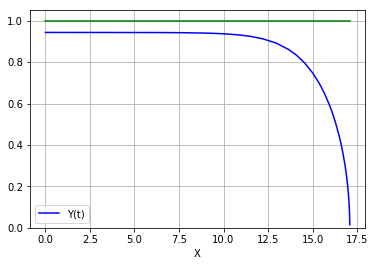

True

In [37]:
H = Hcr
# H = 0.05656565656565656
alpha, beta, s, Y0 = find_Y_front(Re, Ca, H, eps)
X, Y, Yx, Yxx = solve_myode('ivp', fun, Y0, 200, Re, Ca, H, eps, N=1000)

plt.plot(X, 1 - H*Y, 'b', label='Y(t)')
plt.plot([X.min(), X.max()], [1, 1], 'g-')
plt.legend(loc='best')
plt.xlabel('X')
plt.ylim([0,1.05])
# plt.axis ('equal')
plt.grid()

plt.show()
monotonic(Y)

# Compare BPM with the Stone's et al. model

In [38]:
case, Re, Ca, H

('10c', 497.31719545454547, 0.010323076923076923, 0.05656565656565656)

In [39]:
print('CASE:', case)
fig = go.Figure()
xnose=0
# plot BPM
for sheet in sheets:
    if case in sheet:
        try:
            df = df_all[sheet]
            df = df[df['y']>=0]
            x = df['x']
            y = df['y']
        except:
            print('error in sheet:', sheet)
        # sort array x, y. X ascending order
        arr_ = np.array((x,y)).T # make 2D array

        arr, x0, xmin, xmax = sort_by_nearest(arr_)
        type(arr)
#         arr = arr[:,:]
        xmean = 0.5*(xmin + xmax)
        x = arr[:,0]
        y = arr[:,1]

        if 'bpm' in sheet:
            print('x', x)
            print('y', y)
            t = sheet[9:14]
            xnose = x[x>xmean][np.argmin(y[x>xmean])] - x0
            fig.add_trace(go.Scatter(x=x-x0, y=y, name='t=' + t,
                                 mode='lines',
                                 marker = dict(
                                     color = colors['BPM'],
                                     size = 2
        #                                  ,
        #                              line = dict(
        #                               color = 'rgb(231, 99, 250)',
        #                               width = 12
        #                               )
                                 ),
                                 textfont=dict(
                                    family="Times New Roman",
                                    size=18,
                                    color="LightSeaGreen")
                                 ))
#Plot others
if plot_others:
    for sheet in sheets:
        if case in sheet:
            try:
                df = df_all[sheet]
                df = df[df['y']>=0]
                x = df['x']
                y = df['y']

            except:
                print('error in sheet:', sheet)
            # sort array x, y. X ascending order
            arr_ = np.array((x,y)).T # make 2D array
            arr, x0, xmin, xmax = sort_by_nearest(arr_)
            xmean = 0.5*(xmin + xmax)
            x = arr[:,0]
            y = arr[:,1]

            if 'bpm' in sheet:
                if case in '10h':
                    df = df.sort_values('x')
                    xmin, xmax = df['x'].min(), df['x'].max()
                    xmean = 0.5*(xmin + xmax)
                    ind = df['x'] < xmean
                    x = df.iloc[ind]
                    y = df.iloc[ind]
                    
                    
                    
#                     arr_cut[arr[:,0] > 0.5*(xmin + xmax)] = 10e+30
                    iymin = arr_cut[:,1].argmin()
                    x0, y0 = arr[iymin,0], arr[iymin,1]
                    
                    
                    
                    arr = df.to_numpy()
                
                t = sheet[9:14]
                xnose = x[x>xmean][np.argmin(y[x>xmean])] - x0
                fig.add_trace(go.Scatter(x=x-x0, y=y, name='t=' + t,
                                     mode='lines',
                                     marker = dict(
                                         color = colors['BPM'],
                                         size = 2
            #                                  ,
            #                              line = dict(
            #                               color = 'rgb(231, 99, 250)',
            #                               width = 12
            #                               )
                                     ),
                                     textfont=dict(
                                        family="Times New Roman",
                                        size=18,
                                        color="LightSeaGreen")
                                     ))       
            else:
                meth = get_method(sheet)
                if meth == 'experiment':
                    xmin = min(xmin, x0 + x.min())
                    xmax = max(xmax, x0 + x.max())
                    xmin, xmax = x.min(), x.max()
                    xnose_others = x[x>xmean][np.argmin(y[x>xmean])]
                    x += xnose  - xnose_others
                    fig.add_trace(go.Scatter(x=x, y=y, name=meth,
                                     mode='lines',
                                     line=dict(color=colors[meth], width=2),
                                     textfont=dict(
                                        family="Times New Roman",
                                        size=18,
                                        color="LightSeaGreen")
                                     ))

meth='MagniniModel'
x=X*(H*Ca**(-1./3.))/2
xmin, xmax = x.min(), x.max()
x = x - xmax + xnose
y=(1-H*Y)/2

fig.add_trace(go.Scatter(x=x, y=y, name='Magnini et al. model',
                                 mode='lines',
                                 line=dict(color=colors[meth], width=2),
                                 textfont=dict(
                                    family="Times New Roman",
                                    size=18,
                                    color="LightSeaGreen")
                                 ))

fig.add_trace(go.Scatter(
    x=[0, 4],
    y=[0.5, 0.5],
    mode='lines',
    line=dict(color='black', width=1),
    showlegend=False)
)


#     fig.add_trace(go.Scatter(
#         x=[0, xmax - x0],
#         y=[-0.5, -0.5],
#         mode='lines',
#         line=dict(color='black', width=1),
#         showlegend=False)
#     )


fig.update_layout(
    width = params[case]['width'],
    height = params[case]['height'],
#     width = 1000,
#     height = 315,
    xaxis_title='x',
    yaxis_title='y',
    yaxis = yaxis,
    xaxis = xaxis
)
fig.update_layout(bg_style)
fig.update_xaxes(axis_style)
fig.update_yaxes(axis_style)


fig.update_layout(showlegend=False)
#     fig.update_yaxes(dict(range=[0,0.55], showline=True, gridwidth=1, gridcolor='lightgrey', linewidth=1, 
#                           linecolor='black', mirror=True, ticks='outside',
#                  tickfont = dict(family = 'Times New Roman', size = 18, color = 'black')))
fig.update_yaxes(
    scaleanchor = "y",
    scaleratio = 1
)
scale = 3
fig.update_xaxes(dict(
          tickfont = dict(
          size = 10*scale,
          ),
          titlefont = dict(
              size = 13*scale,
          ),
      ))
fig.update_yaxes(dict(
          tickfont = dict(
          size = 10*scale,
          ),
          titlefont = dict(
              size = 13*scale,
          ),
      ))
fig.update_yaxes(range=[0,0.55])
fig.update_xaxes(range=params[case]['xrange'])
# fig.update_xaxes(range=[1.6,2.8])
if True:
    fn = Path(rpath).joinpath('bubble_Stone_model_case=' + case + '.pdf')
    iplot(fig)
    pio.write_image(fig, str(Path(fn)))
    print("Successfully generated:", fn)

CASE: 10c
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577
x [11.5629 11.5627 11.5636 11.5636 11.5637 11.5637 11.5639 11.564  11.5649
 11.5651 11.565  11.5655 11.5659 11.5665 11.5666 11.567  11.5676 11.5681
 11.5687 11.5694 11.5702 11.571  11.5715 11.5719 11.5727 11.5736 11.5745
 11.5756 11.5764 11.5767 11.5777 11.5788 11.58   11.5813 11.5814 11.5826
 11.5839 11.5854 11.5861 11.5869 11.5883 11.5899 11.591  11.5916 11.5932
 11.595  11.5959 11.5969 11.5986 11.6007 11.6008 11.6026 11.6047 11.6057
 11.6069 11.609  11.6106 11.6114 11.6136 11.6155 11.6161 11.6185 11.6204
 11.6212 11.6237 11.6252 11.6265 11.6292 11.6301 11.6321 11.635  11.635
 11.638  11.6399 11.6412 11.6442 11.6448 11.6475 1

Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_case=10c.pdf


In [16]:
# def match(X, Y, Ca, H):
#     if X[0] < X[1]:
#         f = UnivariateSpline(X, Y, k=5, s=0)
#     else:
#         X = X[::-1]
#         Y = Y[::-1]
#         f = UnivariateSpline(X, Y, k=5, s=0)
#     fx = f.derivative(n=1)
#     fxx = f.derivative(n=2)
#     Yi = f(X)
#     Yxi = fx(X)
#     Yxxi = fxx(X)
#     plt.plot(X, H*Y, 'r.')
#     # plt.plot(Xnew, H*Ynew)
# #     plt.plot(X, H*Yi)
# #     plt.plot(X, Yxi, 'b.')
# #     print(Yxi[-40:])
# #     plt.plot(X, Yxxi)
# #     plt.axis('equal')
# #     plt.ylim([0.5,0.53])
# #     plt.xlim([38.9575,38.9625])
#     plt.show()

#     plt.plot(Yi, curvature_sph(Yi, Yxi, Yxxi, Ca, H), 'b.')
#     plt.plot(Yi, curvature    (Yi, Yxi, Yxxi, Ca, H), 'r.')
# #     plt.xlim([8.6,8.8])
#     plt.ylim([0,10])

#     plt.show()
#     return f, fx, fxx

# H_inter = H#0.05
# alpha_inter, beta_inter, s_inter, Y0_inter = find_Y_front(Re, Ca, H_inter, eps)
# X_inter, Y_inter, Yx_inter, Yxx_inter = solve_myode('ivp', fun, Y0, 80, Re, Ca, H_inter, eps, N=100)

# match (X_inter, Y_inter, Ca, H_inter)

In [17]:
# def find_k_ksph(X, Y, Ca, H):
#     f = UnivariateSpline(X, Y, k=5, s=0)
#     fx = f.derivative(n=1)
#     fxx = f.derivative(n=2)
#     x_coarse = np.linspace(X.min(), X.max(), 100)
#     ff = f_cur (x_coarse, f, fx, fxx, Ca, H)
#     i = np.argmin(ff)
#     x0 = x_coarse[i]
#     if False:
#         res = minimize(f_cur_min, x0=x0, args=(f, fx, fxx, Ca, H), method='L-BFGS-B', jac=None,
#                    options={'gtol': 1e-6, 'disp': True})
#     #     print(res)
#         x = res.x[0]
#     else:
#         x = brentq(f_cur, X.min(), X.max(), args = (f, fx, fxx, Ca, H))
#     y = float(f(x))
#     cur = curvature(f(x), fx(x), fxx(x), Ca, H)
#     f_cur_val = f_cur(x, f, fx, fxx, Ca, H)
#     print('x=', x, 'y=', y, 'f_cur(x)=', f_cur_val, 'curvature=', cur)
# #     x = fsolve(f_cur, [50], args=(f, fx, fxx, Ca, H))[0]
#     return x, y, f_cur_val, cur

# Xc_inter, Yc_inter, f_cur_valc, curc = find_k_ksph(X_inter, Y_inter, Ca, H_inter)

In [18]:
# # df_stone = pd.read_csv(Path(rpath).joinpath('datasetStoneFrontMeniscus.txt'), header=None, names=['x/R', 'YH'])
# df_stone = pd.read_csv(Path(rpath).joinpath('data_H=0.04.txt'), header=None, names=['x/R', 'YH'])
# df_stone.head()

In [19]:
# def front_meniscus(X_init, Y_init, Ca, H):
    
#     Xc, Yc, err, cur = find_k_ksph(X_init, Y_init, Ca, H)
#     x_rescale = H*Ca**(-1./3.)
#     X = X_init*x_rescale
#     Xc *= x_rescale
# #     Rad = 2/cur
#     Rad = 2*H/( cur*Ca**(2./3.) )
# #     Rad = 5/cur
#     deltaY = 1 - H*Yc
#     deltaX = np.sqrt(Rad**2 - deltaY**2)
    
#     theta0 = np.arcsin((1 - H*Yc)/Rad)
# #     print(cur, Rad, deltaX, theta0, Yc*H)
#     theta = np.linspace(-theta0, 0, 100)
#     Xnew = Xc + (- deltaX + Rad*cos(theta))/H
#     Ynew = Yc + (  deltaY + Rad*sin(theta))/H
# #     Xnew /= x_rescale
#     return Xnew, Ynew, Xc, Yc

# x_rescale = H_inter*Ca**(-1./3.)

# Xnew, Ynew, Xc, Yc = front_meniscus(X_inter, Y_inter, Ca, H_inter)

# x_scaled = X_inter*x_rescale
# y_scaled = H*Y_inter

# plt.plot(x_scaled - x_scaled.max(), y_scaled)
# x0, y0 = df_stone['x/R'].values[-1], df_stone['YH'].values[-1]
# plt.plot(df_stone['x/R'] - x0, df_stone['YH'])
# plt.plot(Xnew*x_rescale, H*Ynew)
# # plt.plot(Xc, Yc, 'r.')
# # plt.plot(Xnew[-1], Ynew[-1], 'g.')
# # plt.plot([X_inter.min(), X_inter.max()], [1/H_inter, 1/H_inter], 'y')
# # plt.axis('equal')
# plt.ylim([0,1])
# plt.show()

In [20]:
# 1/x_rescale, df_stone['x/R'].values[-1]

In [21]:
H

0.05656565656565656

# Rear of the bubble

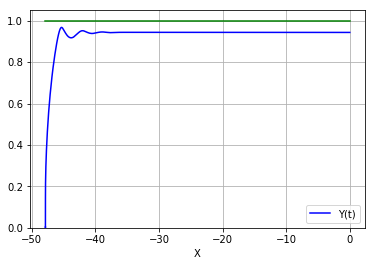

False

In [12]:
H = Hcr
X0, Xf = 0, -60.
Phi = 0.5077321460347141

# Initial conditions:

alpha, beta, s, Y0 = find_Y_rear(Re, Ca, H, gamma, phi=Phi)
X_rear, Y_rear, Yx_rear, Yxx_rear = solve_myode('ivp', fun, Y0, Xf, Re, Ca, H, eps, N=1000)
NN = 400
X_rear = X_rear[:NN]
y = y[:NN]
y = 1 - H*Y_rear[:NN]
plt.plot(X_rear, y, 'b', label='Y(t)')
plt.plot([X_rear.min(), X_rear.max()], [1, 1], 'g-')
plt.legend(loc='best')
plt.xlabel('X')
plt.ylim([0,1.05])
# plt.axis ('equal')
plt.grid()

plt.show()
monotonic(Y_rear)

# Find the best Phi

In [23]:

X0, Xf = 0, -60.

for phi in np.linspace(0,2*pi, 100):
    fig = go.Figure()
    xnose = 0
    xtail = 0
    # plot BPM
    for sheet in sheets:
        if case in sheet:
            try:
                df = df_all[sheet]
                df = df[df['y']>=0]
                x = df['x']
                y = df['y']
            except:
                print('error in sheet:', sheet)
            # sort array x, y. X ascending order
            arr_ = np.array((x,y)).T # make 2D array

            arr, x0, xmin, xmax = sort_by_nearest(arr_)
            xmean = 0.5*(xmin + xmax)
            x = arr[:,0]
            y = arr[:,1]

            if 'bpm' in sheet:
                t = sheet[9:14]
                xnose = x[x>xmean][np.argmin(y[x>xmean])] - x0
                xtail = x[x<xmean][np.argmin(y[x<xmean])] - x0
                fig.add_trace(go.Scatter(x=x-x0, y=y, name='t=' + t,
                                     mode='lines',
                                     marker = dict(
                                         color = colors['BPM'],
                                         size = 2
            #                                  ,
            #                              line = dict(
            #                               color = 'rgb(231, 99, 250)',
            #                               width = 12
            #                               )
                                     ),
                                     textfont=dict(
                                        family="Times New Roman",
                                        size=18,
                                        color="LightSeaGreen")
                                     ))
            else:

                meth = get_method(sheet)
                if meth == 'experiment':
                    xmin = min(xmin, x0 + x.min())
                    xmax = max(xmax, x0 + x.max())
                    xmin, xmax = x.min(), x.max()
                    xnose_others = x[x>xmean][np.argmin(y[x>xmean])]
#                     x += xnose  - xnose_others
                    fig.add_trace(go.Scatter(x=x-x0, y=y, name=meth,
                                     mode='lines',
                                     line=dict(color=colors[meth], width=2),
                                     textfont=dict(
                                        family="Times New Roman",
                                        size=18,
                                        color="LightSeaGreen")
                                     ))
    # Initial conditions:
    alpha, beta, s, Y0 = find_Y_rear(Re, Ca, H, gamma, phi=phi)
    # Solve, using a method resilient to stiff ODEs.
    X_rear, Y_rear, Yx_rear, Yxx_rear = solve_myode('ivp', fun, Y0, Xf, Re, Ca, H, eps, N=1000)
    
    meth='MagniniModel'
    x=X_rear*(H*Ca**(-1./3.))/2
    xmin, xmax = x.min(), x.max()
#     x = x - xmax + xnose
    x = x - xmin + xtail
    y=(1-H*Y_rear)/2
    NN = 400
    X_rear = X_rear[:NN]
    y = y[:NN]
    y = 1 - H*Y_rear[:NN]
    fig.add_trace(go.Scatter(x=x, y=y/2, name='Magnini et al. model',
                                     mode='lines',
                                     line=dict(color=colors[meth], width=2),
                                     textfont=dict(
                                        family="Times New Roman",
                                        size=18,
                                        color="LightSeaGreen")
                                     ))

    fig.add_trace(go.Scatter(
        x=[0, 4],
        y=[0.5, 0.5],
        mode='lines',
        line=dict(color='black', width=1),
        showlegend=False)
    )


    #     fig.add_trace(go.Scatter(
    #         x=[0, xmax - x0],
    #         y=[-0.5, -0.5],
    #         mode='lines',
    #         line=dict(color='black', width=1),
    #         showlegend=False)
    #     )


    fig.update_layout(
        width = params[case]['width'],
        height = params[case]['height'],
    #     width = 1000,
    #     height = 315,
        xaxis_title='x',
        yaxis_title='y',
        yaxis = yaxis,
        xaxis = xaxis
    )
    fig.update_layout(bg_style)
    fig.update_xaxes(axis_style)
    fig.update_yaxes(axis_style)


    fig.update_layout(showlegend=False)
    #     fig.update_yaxes(dict(range=[0,0.55], showline=True, gridwidth=1, gridcolor='lightgrey', linewidth=1, 
    #                           linecolor='black', mirror=True, ticks='outside',
    #                  tickfont = dict(family = 'Times New Roman', size = 18, color = 'black')))
    fig.update_yaxes(
        scaleanchor = "x",
        scaleratio = 1
    )

    fig.update_yaxes(range=[0,0.55])
    fig.update_xaxes(range=params[case]['xrange'])
    fig.update_xaxes(range=[0,1])
    if True:
        fn = Path(rpath).joinpath('bubble_Stone_model_rear_case=' + case + '.pdf')
        iplot(fig)
        pio.write_image(fig, str(Path(fn)))
        print("Successfully generated:", fn)

Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf
Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf


In [24]:
# from scipy.integrate import solve_ivp
# from numpy import sin, cos, pi , exp, round
# # Re = 100
# # Ca = 0.05
# # H = 0.13
# gamma = 1e-6


# # Initial and final times.
# X0, Xf = 0, -40.

# for phi in np.linspace(0,2*pi, 10):
#     print('CASE:', case)
#     fig = go.Figure()
#     for sheet in sheets:
#         if case in sheet:
#             try:
#                 df = df_all[sheet]
#                 df = df[df['y']>=0]
#                 x = df['x']
#                 y = df['y']
#             except:
#                 print('error in sheet:', sheet)
#             # sort array x, y. X ascending order
#             arr_ = np.array((x,y)).T # make 2D array

#             arr, x0, xmin, xmax = sort_by_nearest(arr_)
#             x = arr[:,0]
#             y = arr[:,1]

#             if 'bpm' in sheet:
#                 t = sheet[9:14]
#                 fig.add_trace(go.Scatter(x=x-x0, y=y, name='t=' + t,
#                                      mode='lines',
#                                      marker = dict(
#                                          color = colors['BPM'],
#                                          size = 2
#             #                                  ,
#             #                              line = dict(
#             #                               color = 'rgb(231, 99, 250)',
#             #                               width = 12
#             #                               )
#                                      ),
#                                      textfont=dict(
#                                         family="Times New Roman",
#                                         size=18,
#                                         color="LightSeaGreen")
#                                      ))
# #             else:
# #                 meth = get_method(sheet)
# #                 xmin = min(xmin, x0 + x.min())
# #                 xmax = max(xmax, x0 + x.max())
# #                 fig.add_trace(go.Scatter(x=x, y=y, name=meth,
# #                                      mode='lines',
# #                                      line=dict(color=colors[meth], width=2),
# #                                      textfont=dict(
# #                                         family="Times New Roman",
# #                                         size=18,
# #                                         color="LightSeaGreen")
# #                                      ))




#     fig.add_trace(go.Scatter(
#         x=[0, 4],
#         y=[0.5, 0.5],
#         mode='lines',
#         line=dict(color='black', width=1),
#         showlegend=False)
#     )


# #     fig.add_trace(go.Scatter(
# #         x=[0, xmax - x0],
# #         y=[-0.5, -0.5],
# #         mode='lines',
# #         line=dict(color='black', width=1),
# #         showlegend=False)
# #     )


#     fig.update_layout(
#         width = 1000,
#         height = 315,
#         xaxis_title='x',
#         yaxis_title='y',
#         yaxis = yaxis,
#         xaxis = xaxis
#     )
#     fig.update_layout(bg_style)
#     fig.update_xaxes(axis_style)
#     fig.update_yaxes(axis_style)


#     fig.update_layout(showlegend=False)
#     fig.update_yaxes(range=[0,0.55])
# #     fig.update_yaxes(dict(range=[0,0.55], showline=True, gridwidth=1, gridcolor='lightgrey', linewidth=1, 
# #                           linecolor='black', mirror=True, ticks='outside',
# #                  tickfont = dict(family = 'Times New Roman', size = 18, color = 'black')))
#     fig.update_yaxes(
#         scaleanchor = "x",
#         scaleratio = 1
#     )

#     fig.update_yaxes(range=[0,0.55])
#     fig.update_xaxes(range=[0,3.4])
#     if True:
#         fn = Path(rpath).joinpath('bubble_rear_case=' + case + '.pdf')
#         iplot(fig)
#         pio.write_image(fig, str(Path(fn)))
#         print("Successfully generated:", fn)
    
    
# #################################################################### 
#     # Initial conditions:
#     alpha, beta, s, Y0 = find_Y_rear(Re, Ca, H, gamma, phi=phi)
#     # Solve, using a method resilient to stiff ODEs.
#     X_rear, Y_rear, Yx_rear, Yxx_rear = solve_myode('ivp', fun, Y0, Xf, Re, Ca, H, eps, N=1000)
    
#     meth='MagniniModel'
#     x = X_rear*(H*Ca**(-1./3.))/2
#     xmin, xmax = X_rear.min(), X_rear.max()
#     x = X_rear - xmax + xnose
#     y=(1-H*Y)/2
#     plt.plot(X_rear, Y_rear, label='Y, phi='+str(round(phi,2)))
#     for sheet in sheets:
#         if case in sheet:
#             try:
#                 df = df_all[sheet]
#                 df = df[df['y']>=0]
#                 x = df['x']
#                 y = df['y']
#             except:
#                 print('error in sheet:', sheet)
#             # sort array x, y. X ascending order
#             arr_ = np.array((x,y)).T # make 2D array

#             arr, x0, xmin, xmax = sort_by_nearest(arr_)
#             xmean = 0.5*(xmin + xmax)
#             x = arr[:,0]
#             y = arr[:,1]

#             if 'bpm' in sheet:
#                 plt.plot(x, y, label='Y, BPM')
# #     match (X_rear, Y_rear, Ca, H)
#     plt.xlabel('X')
#     plt.ylabel('Y')
#     plt.legend()
#     # plt.axis('equal')
#     plt.grid()
#     plt.show()

In [14]:

X0, Xf = 0, -60.

# for phi in np.linspace(0,2*pi, 100):
for phi in [Phi]:
    fig = go.Figure()
    xnose = 0
    xtail = 0
    # plot BPM
    for sheet in sheets:
        if case in sheet:
            try:
                df = df_all[sheet]
                df = df[df['y']>=0]
                x = df['x']
                y = df['y']
            except:
                print('error in sheet:', sheet)
            # sort array x, y. X ascending order
            arr_ = np.array((x,y)).T # make 2D array

            arr, x0, xmin, xmax = sort_by_nearest(arr_)
            xmean = 0.5*(xmin + xmax)
            x = arr[:,0]
            y = arr[:,1]

            if 'bpm' in sheet:
                t = sheet[9:14]
                xnose = x[x>xmean][np.argmin(y[x>xmean])] - x0
                xtail = x[x<xmean][np.argmin(y[x<xmean])] - x0
                fig.add_trace(go.Scatter(x=x-x0, y=y, name='t=' + t,
                                     mode='lines',
                                     marker = dict(
                                         color = colors['BPM'],
                                         size = 2
            #                                  ,
            #                              line = dict(
            #                               color = 'rgb(231, 99, 250)',
            #                               width = 12
            #                               )
                                     ),
                                     textfont=dict(
                                        family="Times New Roman",
                                        size=18,
                                        color="LightSeaGreen")
                                     ))
            else:

                meth = get_method(sheet)
                if meth == 'experiment':
                    xmin = min(xmin, x0 + x.min())
                    xmax = max(xmax, x0 + x.max())
                    xmin, xmax = x.min(), x.max()
                    xnose_others = x[x>xmean][np.argmin(y[x>xmean])]
#                     x += xnose  - xnose_others
                    fig.add_trace(go.Scatter(x=x-x0, y=y, name=meth,
                                     mode='lines',
                                     line=dict(color=colors[meth], width=2),
                                     textfont=dict(
                                        family="Times New Roman",
                                        size=18,
                                        color="LightSeaGreen")
                                     ))
    # Initial conditions:
    alpha, beta, s, Y0 = find_Y_rear(Re, Ca, H, gamma, phi=phi)
    # Solve, using a method resilient to stiff ODEs.
    X_rear, Y_rear, Yx_rear, Yxx_rear = solve_myode('ivp', fun, Y0, Xf, Re, Ca, H, eps, N=1000)
    
    meth='MagniniModel'
    x=X_rear*(H*Ca**(-1./3.))/2
    xmin, xmax = x.min(), x.max()
#     x = x - xmax + xnose
    x = x - xmin + xtail
    y=(1-H*Y_rear)/2
    NN = 400
    X_rear = X_rear[:NN]
    y = y[:NN]
    y = 1 - H*Y_rear[:NN]
    fig.add_trace(go.Scatter(x=x, y=y/2, name='Magnini et al. model',
                                     mode='lines',
                                     line=dict(color=colors[meth], width=2),
                                     textfont=dict(
                                        family="Times New Roman",
                                        size=18,
                                        color="LightSeaGreen")
                                     ))

    fig.add_trace(go.Scatter(
        x=[-1, 4],
        y=[0.5, 0.5],
        mode='lines',
        line=dict(color='black', width=1),
        showlegend=False)
    )


    #     fig.add_trace(go.Scatter(
    #         x=[0, xmax - x0],
    #         y=[-0.5, -0.5],
    #         mode='lines',
    #         line=dict(color='black', width=1),
    #         showlegend=False)
    #     )


    fig.update_layout(
        width = params[case]['width'],
        height = params[case]['height'],
    #     width = 1000,
    #     height = 315,
        xaxis_title='x',
        yaxis_title='y',
        yaxis = yaxis,
        xaxis = xaxis
    )
    fig.update_layout(bg_style)
    fig.update_xaxes(axis_style)
    fig.update_yaxes(axis_style)


    fig.update_layout(showlegend=False)
    #     fig.update_yaxes(dict(range=[0,0.55], showline=True, gridwidth=1, gridcolor='lightgrey', linewidth=1, 
    #                           linecolor='black', mirror=True, ticks='outside',
    #                  tickfont = dict(family = 'Times New Roman', size = 18, color = 'black')))
    fig.update_yaxes(
        scaleanchor = "x",
        scaleratio = 1
    )

    fig.update_yaxes(range=[0,0.55])
    fig.update_xaxes(range=params[case]['xrange'])
    fig.update_xaxes(range=[0,1])
    
    scale = 1.5
    fig.update_xaxes(dict(
              tickfont = dict(
              size = 10*scale,
              ),
              titlefont = dict(
                  size = 13*scale,
              ),
          ))
    fig.update_yaxes(dict(
              tickfont = dict(
              size = 10*scale,
              ),
              titlefont = dict(
                  size = 13*scale,
              ),
          ))
    if True:
        fn = Path(rpath).joinpath('bubble_Stone_model_rear_case=' + case + '.pdf')
        iplot(fig)
        pio.write_image(fig, str(Path(fn)))
        print("Successfully generated:", fn)

Starting point: 0.0 0.0
MinMax point X: 0.0 2.79408560311284
Starting point: -0.004921907293387018 0.01399885868299753
MinMax point X: -0.004921907293387018 2.676272947367358
Starting point: 0.005643221293279689 0.004731687669423387
MinMax point X: 0.003882366528835184 2.293580511894765
Starting point: 11.5629 0.00246305
MinMax point X: 11.5627 14.2577


Successfully generated: /Users/weugene/basilisk/work/tube/bubble_Stone_model_rear_case=10c.pdf


In [ ]:
def find_best_phi(fun, Xf, eps, Re, Ca, H, gamma):    
    # Initial conditions:
    _, _, _, Y0 = find_Y_rear(Re, Ca, H, gamma, phi=phi)
    # Solve, using a method resilient to stiff ODEs.
    X_rear, Y_rear, Yx_rear, Yxx_rear = solve_myode('ivp', fun, Y0, Xf, Re, Ca, H, eps, N=1000)